In [1]:
import librosa
import librosa.display
import IPython.display
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.style as ms
ms.use('seaborn-muted')
%matplotlib inline

In [2]:
def flattenseveryxrows(myarray, x):
    if myarray.shape[0] % x != 0:
        a = x - myarray.shape[0] % x 
        fill = np.zeros((a,myarray.shape[1]))
        myarray = np.concatenate((myarray,fill))
    return myarray.reshape((int(myarray.shape[0] / x), x*myarray.shape[1]))

In [3]:
y, sr = librosa.load("whittakeri.wav", sr=44100)

In [4]:
IPython.display.Audio(data=y, rate=sr)

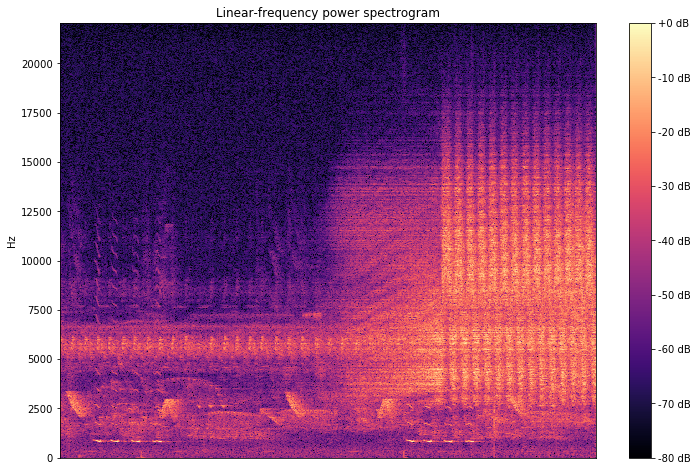

In [5]:
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)
plt.figure(figsize=(12,8))
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [13]:
Y_dB.shape[0]

2049

In [6]:
y_axis = np.multiply(list(range(0,683)),22050/(683))    # eixo y em freq, nao bins

Y_amp_f = flattenseveryxrows(Y_dB,3).mean(1)
Y_var = flattenseveryxrows(Y_dB,3).var(1)

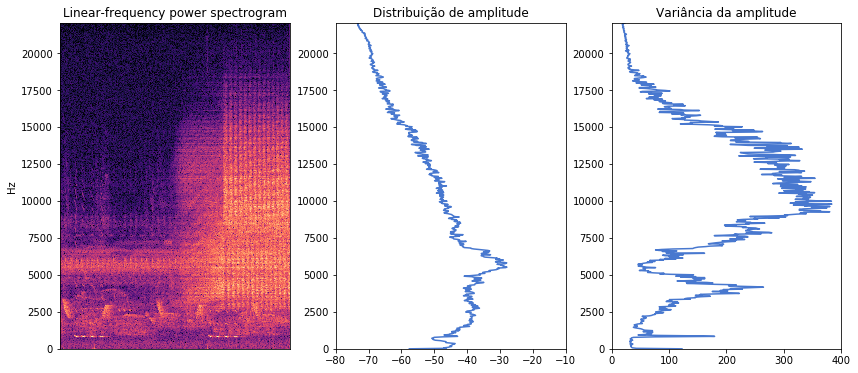

In [9]:
plt.figure(figsize=(14,6))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
plt.plot(Y_amp_f,y_axis)
plt.title("Distribuição de amplitude")
plt.axis([-80,-10,0,22050])

plt.subplot(1,3,3)
plt.plot(Y_var,y_axis)
plt.axis([0,400,0,22050])
plt.title("Variância da amplitude")

In [7]:
Y1 = Y_dB[:,0:500]
Y2 = Y_dB[:,500:1000]
Y3 = Y_dB[:,1000:]

Y_amp1 = Y1.mean(1)
Y_amp2 = Y2.mean(1)
Y_amp3 = Y3.mean(1)


Y_var1 = Y1.var(1)
Y_var2 = Y2.var(1)
Y_var3 = Y3.var(1)


y_axis = np.multiply(list(range(0,2049)),22050/(2049))    # eixo y em freq, nao bins

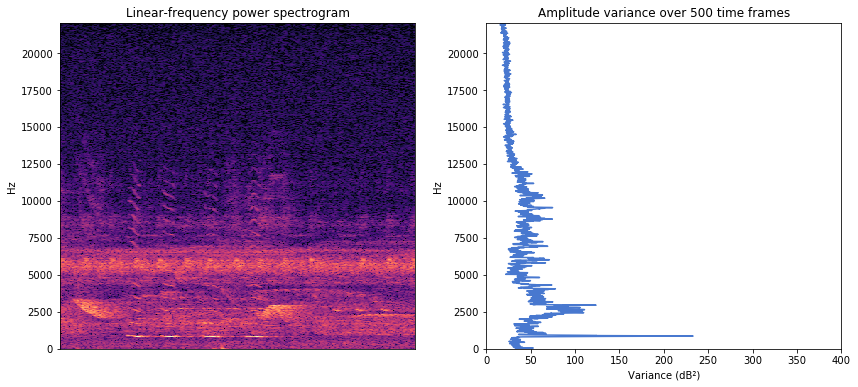

In [8]:
plt.figure(figsize=(14,6))
plt.subplot(1,2,1)
librosa.display.specshow(Y1, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

# plt.subplot(1,3,2)
# plt.plot(Y_amp1,y_axis)
# plt.title("Distribuição de amplitude")
# plt.axis([-80,-20,0,22050])

plt.subplot(1,2,2)
plt.plot(Y_var1,y_axis)
plt.ylabel('Hz')
plt.axis([0,400,0,22050])
plt.xlabel('Variance (dB²)')
plt.title("Amplitude variance over 500 time frames")

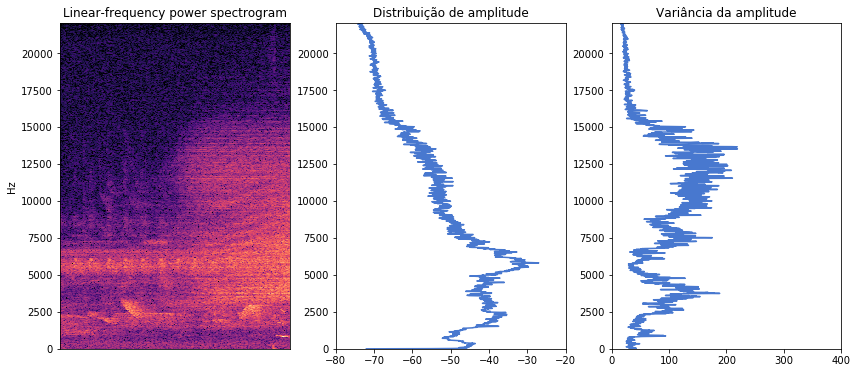

In [10]:
plt.figure(figsize=(14,6))
plt.subplot(1,3,1)
librosa.display.specshow(Y2, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
plt.plot(Y_amp2,y_axis)
plt.title("Distribuição de amplitude")
plt.axis([-80,-20,0,22050])

plt.subplot(1,3,3)
plt.plot(Y_var2,y_axis)
plt.axis([0,400,0,22050])
plt.title("Variância da amplitude")

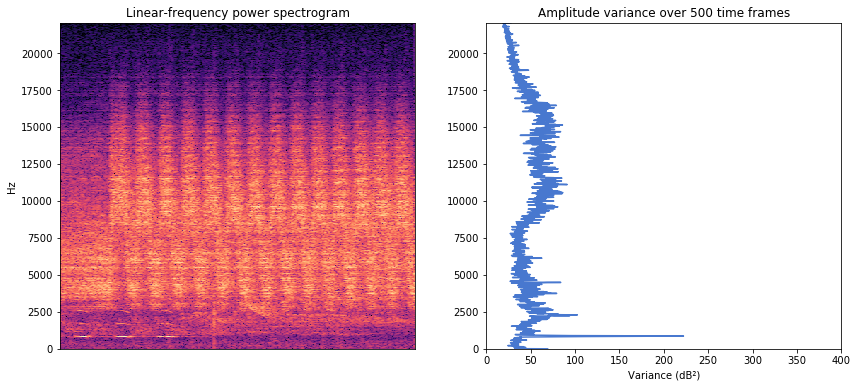

In [9]:
plt.figure(figsize=(14,6))
plt.subplot(1,2,1)
librosa.display.specshow(Y3, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

# plt.subplot(1,3,2)
# plt.plot(Y_amp3,y_axis)
# plt.title("Distribuição de amplitude")
# plt.axis([-80,-20,0,22050])

plt.subplot(1,2,2)
plt.plot(Y_var3,y_axis)
plt.axis([0,400,0,22050])
plt.xlabel('Variance (dB²)')
plt.title("Amplitude variance over 500 time frames")

# Construindo a máscara binária

In [12]:
x = 3
A = flattenseveryxrows(Y_dB[:,:300], x)     # pega começo do sinal, achata 3 linhas (cada faixa de freq=3bins)
y = np.multiply(list(range(0,A.shape[0])),22050/A.shape[0])

In [13]:
thresholds = np.add(A.mean(1), -5)   # thresholds sao media -5dB

thresholds = thresholds.reshape((2049/x,1))
results = A > thresholds
final_result = np.divide(results.sum(1),300*x)
final_result = final_result.reshape(2049/x,1)

C = A.var(1)

/home/nicolas/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:3: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  app.launch_new_instance()
/home/nicolas/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:6: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


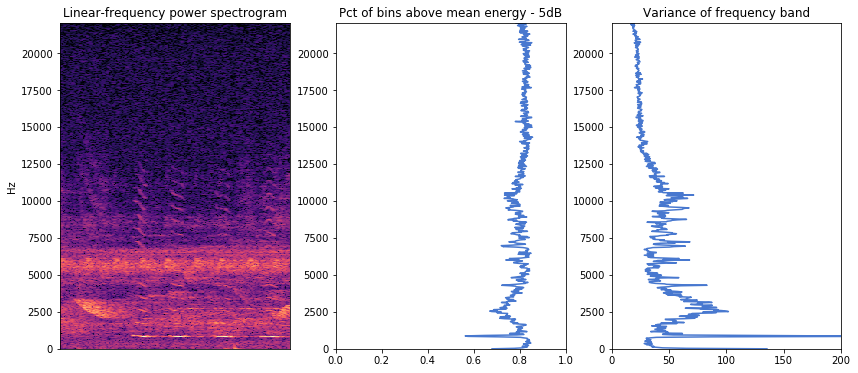

In [14]:
plt.figure(figsize=(14,6))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB[:,:300], y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
plt.plot(final_result,y)
plt.axis([0,1,0,22050])
plt.title('Pct of bins above mean energy - 5dB')

plt.subplot(1,3,3)
plt.plot(C,y)
plt.axis([0,200,0,22050])
plt.title('Variance of frequency band')

In [158]:
y, sr = librosa.load("whittakeri.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

Y_p = Y[:,:300]
Y_dB_p = Y_dB[:,:300]

In [159]:
thresholds = np.add(Y_dB_p.mean(1), 5)   # thresholds sao media -5dB
thresholds = thresholds.reshape((2049,1))

mask = Y_dB_p > thresholds

In [160]:
mag, phase = librosa.magphase(Y_p)
mag = np.multiply(mag, mask)

Y_reconstructed = np.multiply(mag, np.exp(np.multiply(phase, (1j))))

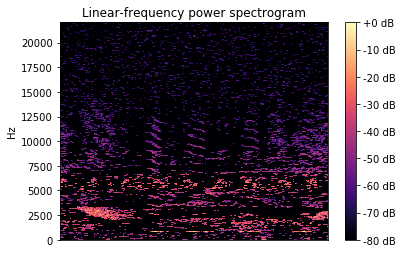

In [161]:
librosa.display.specshow(librosa.amplitude_to_db(Y_reconstructed, np.max), y_axis='linear', sr=sr, hop_length = 512)
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [190]:
y_reconstructed = librosa.istft(Y_reconstructed, hop_length=512)

In [191]:
IPython.display.Audio(data=y_reconstructed, rate=sr)

# Filtrando todo o sinal

## Usando 1 bin como faixa de frequência

In [20]:
y, sr = librosa.load("whittakeri.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

In [21]:
mask = np.empty([2049,1])

numFrames = 25
x = int(Y.shape[1]/numFrames)


for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    thresholds = np.add(Y_dB_p.mean(1), 5)   # thresholds sao media +5dB
    thresholds = thresholds.reshape((2049,1))
    mask_p = Y_dB_p > thresholds
    mask = np.hstack((mask, mask_p))

In [22]:
mask = np.delete(mask,0,1)
mask = np.hstack((mask, np.ones([2049,2])))

In [23]:
mag, phase = librosa.magphase(Y)
mag = np.multiply(mag, mask)
Y_reconstructed = np.multiply(mag, np.exp(np.multiply(phase, (1j))))

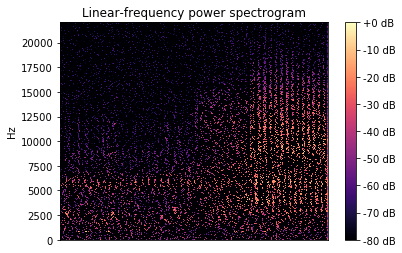

In [24]:
librosa.display.specshow(librosa.amplitude_to_db(Y_reconstructed, np.max), y_axis='linear', sr=sr, hop_length = 512)
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [25]:
y_reconstructed = librosa.istft(Y_reconstructed, hop_length=512)

In [26]:
IPython.display.Audio(data=y_reconstructed, rate=sr)

In [27]:
IPython.display.Audio(data=y, rate=sr)

## Usando 5 bins como faixa de frequência

In [28]:
y, sr = librosa.load("whittakeri.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

In [29]:
flattenseveryxrows(Y_dB, 3).shape

(683, 4506)

In [30]:
mask = np.empty([2049,1])

numFrames = 10
x = int(Y.shape[1]/numFrames)


for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    Y_dB_p_flat = flattenseveryxrows(Y_dB_p, 3)
    
    thresholds = np.add(Y_dB_p_flat.mean(1), 5)   # thresholds sao media +5dB
    thresholds = thresholds.reshape((683,1))
    thresholds = np.repeat(thresholds, 3, 0)     # WHAT
    
    mask_p = Y_dB_p > thresholds
    mask = np.hstack((mask, mask_p))

In [31]:
mask = np.delete(mask,0,1)
mask = np.hstack((mask, np.ones([2049,2])))

In [32]:
mag, phase = librosa.magphase(Y)
mag = np.multiply(mag, mask)
Y_reconstructed = np.multiply(mag, np.exp(np.multiply(phase, (1j))))

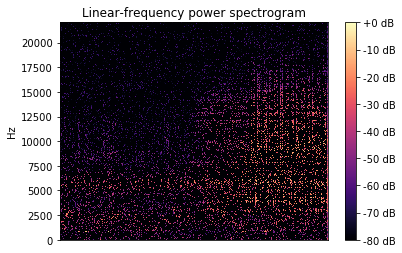

In [33]:
librosa.display.specshow(librosa.amplitude_to_db(Y_reconstructed, np.max), y_axis='linear', sr=sr, hop_length = 512)
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [34]:
y_reconstructed = librosa.istft(Y_reconstructed, hop_length=512)

In [35]:
IPython.display.Audio(data=y_reconstructed, rate=sr)

## Usando 10 bins como faixa de frequencia

In [36]:
y, sr = librosa.load("whittakeri.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

In [37]:
mask = np.empty([2049,1])

numFrames = 10
x = int(Y.shape[1]/numFrames)


for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    Y_dB_p_flat = flattenseveryxrows(Y_dB_p, 10)
    
    thresholds = np.add(Y_dB_p_flat.mean(1), 5)   # thresholds sao media +5dB
    thresholds = thresholds.reshape((205,1))
    thresholds = np.repeat(thresholds, 10, 0)
    thresholds = np.delete(thresholds, indiceStop, 0)
    
    mask_p = Y_dB_p > thresholds
    mask = np.hstack((mask, mask_p))

In [38]:
mask = np.delete(mask,0,1)
mask = np.hstack((mask, np.ones([2049,2])))

In [39]:
mag, phase = librosa.magphase(Y)
mag = np.multiply(mag, mask)
Y_reconstructed = np.multiply(mag, np.exp(np.multiply(phase, (1j))))

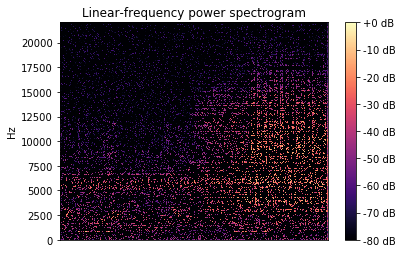

In [40]:
librosa.display.specshow(librosa.amplitude_to_db(Y_reconstructed, np.max), y_axis='linear', sr=sr, hop_length = 512)
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [41]:
y_reconstructed = librosa.istft(Y_reconstructed, hop_length=512)

In [42]:
IPython.display.Audio(data=y_reconstructed, rate=sr)

# Máscaras não binárias

## Média

In [164]:
y, sr = librosa.load("whittakeri.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

In [117]:
mask = np.empty([2049,1])

numFrames = 100
x = int(Y.shape[1]/numFrames)

for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    Y_dB_p_flat = flattenseveryxrows(Y_dB_p, 3)
    
    thresholds = Y_dB_p_flat.mean(1)
    thresholds = thresholds.reshape((683,1))
    thresholds = np.repeat(thresholds, 3, 0)
    thresholds = np.repeat(thresholds, numFrames, 1)

    
    mask_p = thresholds/2
    mask = np.hstack((mask, mask_p))

In [118]:
mask = np.delete(mask,0,1)
mask = np.hstack((mask, np.ones([2049,2])))

In [119]:
mag, phase = librosa.magphase(Y)
newmag = librosa.db_to_amplitude(np.add(Y_dB, mask))
Y_reconstructed = np.multiply(newmag, np.exp(np.multiply(phase, (1j))))

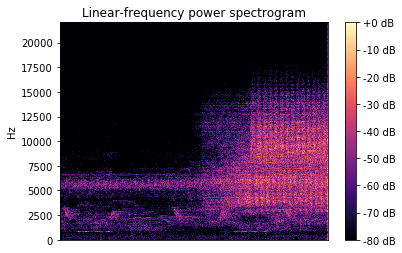

In [120]:
librosa.display.specshow(librosa.amplitude_to_db(Y_reconstructed, np.max), y_axis='linear', sr=sr, hop_length = 512)
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [121]:
y_reconstructed = librosa.istft(Y_reconstructed, hop_length=512)
IPython.display.Audio(data=y_reconstructed, rate=sr)

## Variância

In [175]:
mask = np.empty([2049,1])

numFrames = 100
x = int(Y.shape[1]/numFrames)


for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    Y_dB_p_flat = flattenseveryxrows(Y_dB_p, 3)
    
    thresholds = Y_dB_p_flat.var(1)
    thresholds = thresholds.reshape((683,1))
    thresholds = np.repeat(thresholds, 3, 0)
    thresholds = np.repeat(thresholds, numFrames, 1)

    
    mask_p = thresholds/5
    mask = np.hstack((mask, mask_p))

In [176]:
mask = np.delete(mask,0,1)
mask = np.hstack((mask, np.ones([2049,2])))

In [177]:
mag, phase = librosa.magphase(Y)
newmag = librosa.db_to_amplitude(np.add(Y_dB, mask))
Y_reconstructed = np.multiply(newmag, np.exp(np.multiply(phase, (1j))))

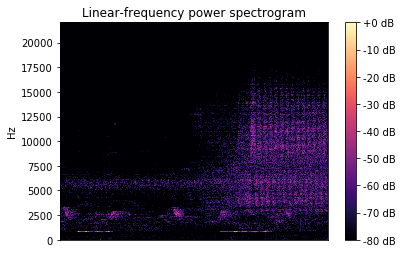

In [178]:
librosa.display.specshow(librosa.amplitude_to_db(Y_reconstructed, np.max), y_axis='linear', sr=sr, hop_length = 512)
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [179]:
y_reconstructed = librosa.istft(Y_reconstructed, hop_length=512)
IPython.display.Audio(data=y_reconstructed, rate=sr)

## Outro canto: pompeu

In [180]:
y, sr = librosa.load("pompeu.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

In [182]:
IPython.display.Audio(data=y, rate=sr)

In [58]:
Y_amp = flattenseveryxrows(Y_dB, 3).mean(1)
Y_var = flattenseveryxrows(Y_dB, 3).var(1)

y_axis = np.multiply(list(range(0,683)),22050/(683))    # eixo y em freq, nao bins

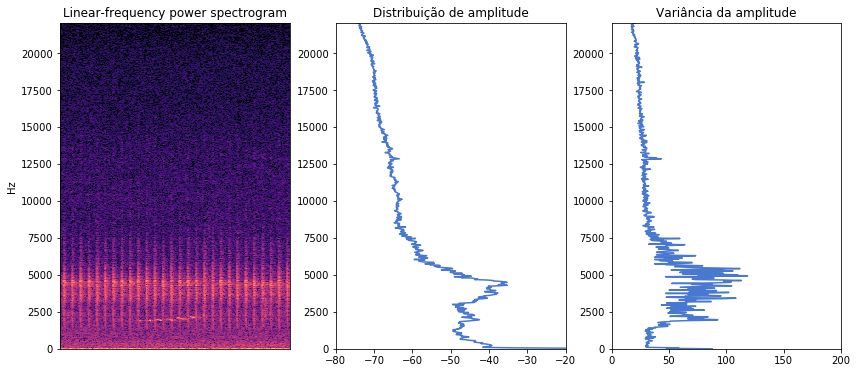

In [59]:
plt.figure(figsize=(14,6))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
plt.plot(Y_amp,y_axis)
plt.title("Distribuição de amplitude")
plt.axis([-80,-20,0,22050])

plt.subplot(1,3,3)
plt.plot(Y_var,y_axis)
plt.axis([0,200,0,22050])
plt.title("Variância da amplitude")

In [60]:
mask = np.empty([2049,1])

numFrames = 10
x = int(Y.shape[1]/numFrames)


for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    Y_dB_p_flat = flattenseveryxrows(Y_dB_p, 3)
    
    thresholds = np.add(Y_dB_p_flat.mean(1), 5)   # thresholds sao media +5dB
    thresholds = thresholds.reshape((683,1))
    thresholds = np.repeat(thresholds, 3, 0)
    
    mask_p = Y_dB_p > thresholds
    mask = np.hstack((mask, mask_p))

In [61]:
mask = np.delete(mask,0,1)
#mask = np.hstack((mask, np.ones([2049,2])))

In [62]:
mask.shape

(2049, 500)

In [63]:
mag, phase = librosa.magphase(Y)
mag = np.multiply(mag, mask)
Y_reconstructed = np.multiply(mag, np.exp(np.multiply(phase, (1j))))

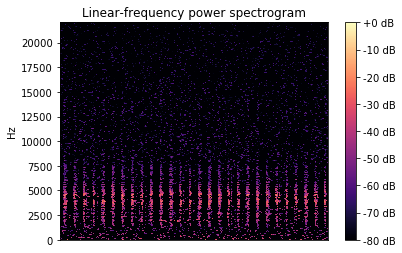

In [64]:
librosa.display.specshow(librosa.amplitude_to_db(Y_reconstructed, np.max), y_axis='linear', sr=sr, hop_length = 512)
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [65]:
y_reconstructed = librosa.istft(Y_reconstructed, hop_length=512)

In [66]:
IPython.display.Audio(data=y_reconstructed, rate=sr)

In [67]:
mask = np.empty([2049,1])

numFrames = 100
x = int(Y.shape[1]/numFrames)


for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    Y_dB_p_flat = flattenseveryxrows(Y_dB_p, 10)
    
    thresholds = Y_dB_p_flat.var(1)
    thresholds = thresholds.reshape((205,1))
    thresholds = np.repeat(thresholds, 10, 0)
    thresholds = np.repeat(thresholds, numFrames, 1)

    thresholds = np.delete(thresholds, indiceStop, 0)
    
    mask_p = thresholds/5
    mask = np.hstack((mask, mask_p))

In [68]:
mask = np.delete(mask,0,1)
#mask = np.hstack((mask, np.ones([2049,2])))

In [69]:
mag, phase = librosa.magphase(Y)
newmag = librosa.db_to_amplitude(np.add(Y_dB, mask))
Y_reconstructed = np.multiply(newmag, np.exp(np.multiply(phase, (1j))))

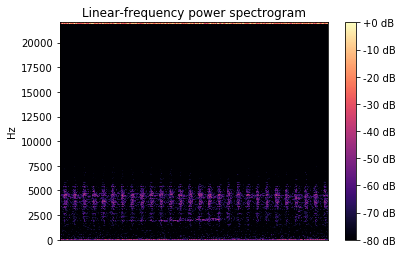

In [70]:
librosa.display.specshow(librosa.amplitude_to_db(Y_reconstructed, np.max), y_axis='linear', sr=sr, hop_length = 512)
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [71]:
y_reconstructed = librosa.istft(Y_reconstructed, hop_length=512)

In [72]:
IPython.display.Audio(data=y_reconstructed, rate=sr)

# Outros sons

In [130]:
y, sr = librosa.load("macularius.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

In [131]:
y_axis = np.multiply(list(range(0,2049)),22050/2049)    # eixo y em freq, nao bins
Y_amp = Y_dB.mean(1)
Y_var = Y_dB.var(1)

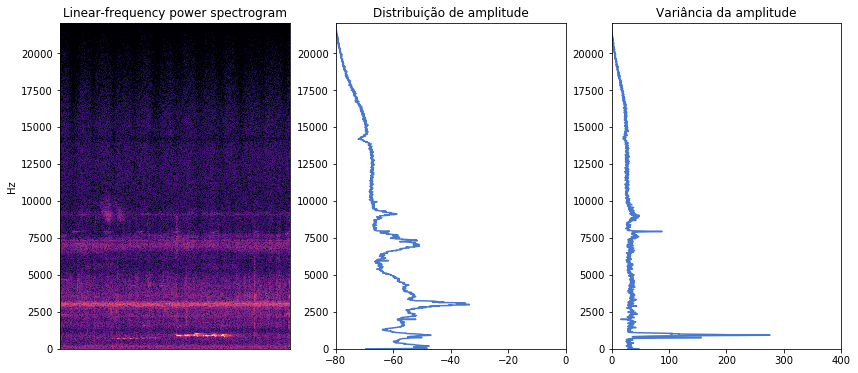

In [132]:
plt.figure(figsize=(14,6))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
plt.plot(Y_amp,y_axis)
plt.title("Distribuição de amplitude")
plt.axis([-80,0,0,22050])

plt.subplot(1,3,3)
plt.plot(Y_var,y_axis)
plt.axis([0,400,0,22050])
plt.title("Variância da amplitude")

In [133]:
mask = np.empty([2049,1])

numFrames = 100
x = int(Y.shape[1]/numFrames)


for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    Y_dB_p_flat = flattenseveryxrows(Y_dB_p, 10)
    
    thresholds = Y_dB_p_flat.var(1)
    thresholds = thresholds.reshape((205,1))
    thresholds = np.repeat(thresholds, 10, 0)
    thresholds = np.repeat(thresholds, numFrames, 1)

    thresholds = np.delete(thresholds, indiceStop, 0)
    
    mask_p = thresholds/5
    mask = np.hstack((mask, mask_p))
    
mask = np.delete(mask,0,1)
#mask = np.hstack((mask, np.ones([2049,2])))

mag, phase = librosa.magphase(Y)
Y_dB_p = Y_dB[:,:900]
newmag = librosa.db_to_amplitude(np.add(Y_dB_p, mask))
Y_reconstructed = np.multiply(newmag, np.exp(np.multiply(phase[:,:900], (1j))))

In [134]:
IPython.display.Audio(data=y, rate=sr)

In [135]:
IPython.display.Audio(data=librosa.istft(Y_reconstructed, hop_length=512), rate=sr)

In [136]:
y, sr = librosa.load("natteri.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

In [137]:
y_axis = np.multiply(list(range(0,2049)),22050/2049)    # eixo y em freq, nao bins
Y_amp = Y_dB.mean(1)
Y_var = Y_dB.var(1)

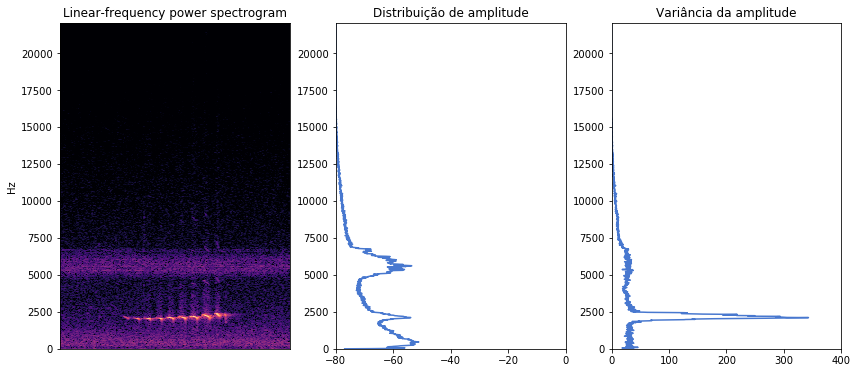

In [138]:
plt.figure(figsize=(14,6))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
plt.plot(Y_amp,y_axis)
plt.title("Distribuição de amplitude")
plt.axis([-80,0,0,22050])

plt.subplot(1,3,3)
plt.plot(Y_var,y_axis)
plt.axis([0,400,0,22050])
plt.title("Variância da amplitude")

In [141]:
mask = np.empty([2049,1])

numFrames = 100
x = int(Y.shape[1]/numFrames)


for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    Y_dB_p_flat = flattenseveryxrows(Y_dB_p, 10)
    
    thresholds = Y_dB_p_flat.var(1)
    thresholds = thresholds.reshape((205,1))
    thresholds = np.repeat(thresholds, 10, 0)
    thresholds = np.repeat(thresholds, numFrames, 1)

    thresholds = np.delete(thresholds, indiceStop, 0)
    
    mask_p = thresholds/5
    mask = np.hstack((mask, mask_p))
    
mask = np.delete(mask,0,1)
#mask = np.hstack((mask, np.ones([2049,2])))

mag, phase = librosa.magphase(Y)
Y_dB_p = Y_dB[:,:400]
newmag = librosa.db_to_amplitude(np.add(Y_dB_p, mask))
Y_reconstructed = np.multiply(newmag, np.exp(np.multiply(phase[:,:400], (1j))))

In [142]:
IPython.display.Audio(data=y, rate=sr)

In [143]:
IPython.display.Audio(data=librosa.istft(Y_reconstructed, hop_length=512), rate=sr)

In [144]:
y, sr = librosa.load("paraensis.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

In [145]:
y_axis = np.multiply(list(range(0,2049)),22050/2049)    # eixo y em freq, nao bins
Y_amp = Y_dB.mean(1)
Y_var = Y_dB.var(1)

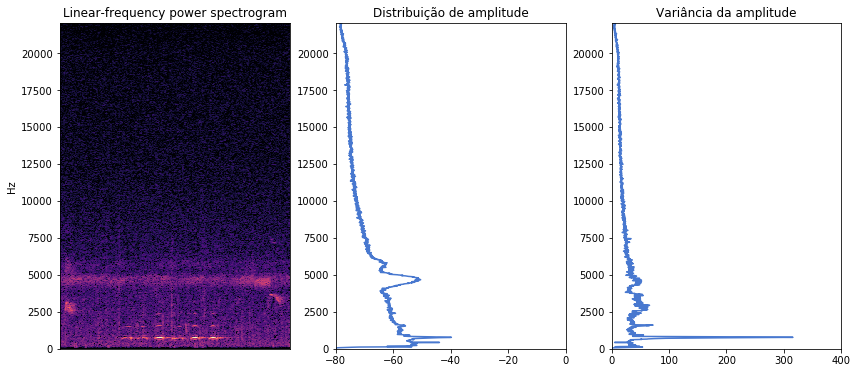

In [146]:
plt.figure(figsize=(14,6))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
plt.plot(Y_amp,y_axis)
plt.title("Distribuição de amplitude")
plt.axis([-80,0,0,22050])

plt.subplot(1,3,3)
plt.plot(Y_var,y_axis)
plt.axis([0,400,0,22050])
plt.title("Variância da amplitude")

In [149]:
mask = np.empty([2049,1])

numFrames = 100
x = int(Y.shape[1]/numFrames)


for i in range(0,x):
    indiceStart = i*numFrames
    indiceStop = indiceStart+numFrames
    Y_dB_p = Y_dB[:,indiceStart:indiceStop]
    
    Y_dB_p_flat = flattenseveryxrows(Y_dB_p, 10)
    
    thresholds = Y_dB_p_flat.var(1)
    thresholds = thresholds.reshape((205,1))
    thresholds = np.repeat(thresholds, 10, 0)
    thresholds = np.repeat(thresholds, numFrames, 1)

    thresholds = np.delete(thresholds, indiceStop, 0)
    
    mask_p = thresholds/5
    mask = np.hstack((mask, mask_p))
    
mask = np.delete(mask,0,1)
#mask = np.hstack((mask, np.ones([2049,2])))

mag, phase = librosa.magphase(Y)
Y_dB_p = Y_dB[:,:500]
newmag = librosa.db_to_amplitude(np.add(Y_dB_p, mask))
Y_reconstructed = np.multiply(newmag, np.exp(np.multiply(phase[:,:500], (1j))))

In [150]:
IPython.display.Audio(data=y, rate=sr)

In [151]:
IPython.display.Audio(data=librosa.istft(Y_reconstructed, hop_length=512), rate=sr)